# Creation des Figures du rapport de visualisation

## Importation des principales librairies et du jeux de donnees

In [1]:
%config Completer.use_jedi = False

# Je narrivait pas a installer la librairy textBlob depuis la UI Anaconda
# Les 3 lignes ci-dessous sont a faire tourner une seule fois:

#import sys
#!{sys.executable} -m pip install textblob
#!{sys.executable} -m pip install textblob_fr

import sys
!{sys.executable} -m pip install flair

import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import seaborn as sns
import matplotlib.pyplot as plt

fileName = 'df_complet.xlsx'
pathName = './Data'


# df=pd.read_excel(f'{pathName}\{fileName}')
df=pd.read_excel(f'{pathName}\{fileName}')

# Je supprime les lignes sans commentaires pour le moment:
df = df.dropna(subset='Commentaire')
df = df.drop(df[df['Commentaire'].isnull()].index)

df.Commentaire = df.Commentaire.str.lower()

### Figure 1: Repartion des avis par note selon statut verifie

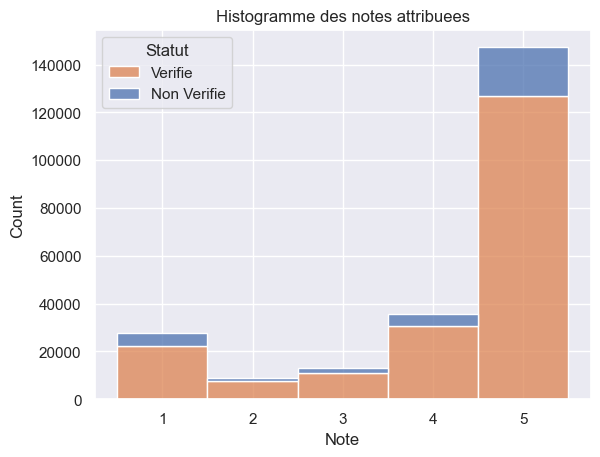

1    0.852744
0    0.147256
Name: Verifications, dtype: float64


In [2]:
sns.set_theme()
fig0 = sns.histplot(data=df,x='Note',hue='Verifications', multiple="stack",discrete=True)
fig0.set(title='Histogramme des notes attribuees')
plt.legend(title='Statut', loc='upper left', labels=['Verifie','Non Verifie'])
plt.show()

print(df.Verifications.value_counts(normalize=True))

Commentaire

### Figure 2: Repartition des Pays

In [3]:
print(df.Pays.value_counts(normalize=True))

FR    0.982333
CH    0.003795
US    0.001854
GB    0.001764
BE    0.001342
        ...   
NZ    0.000004
BB    0.000004
LB    0.000004
TT    0.000004
NE    0.000004
Name: Pays, Length: 123, dtype: float64


On remarque que les commentaires sont dorigines Francaises a 98%.
Les autres nationnalites ne sont donc pas representatives dans ce jeux de donnes.

### Figure 3: Notes categorise par le statut verifications

Index(['Unnamed: 0', 'Client', 'Nombre_avis_publie', 'Note', 'Titres',
       'Commentaire', 'Date_experience', 'Date_publication', 'Reponse',
       'Date_reponse', 'Pays', 'Verifications', 'Entreprise'],
      dtype='object')
False    0.769199
True     0.230801
Name: isResponse, dtype: float64


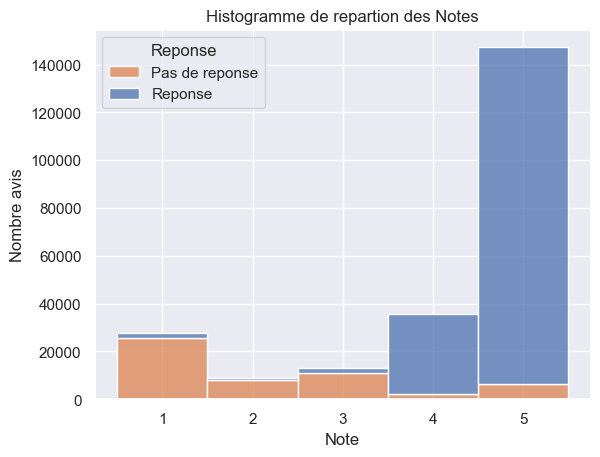

In [4]:
# Dans cette cellule je teste et compare les plots issues de plotly et seaborn
# Un seul des 2 plots sera conserve

print(df.columns)

df['iscommentaire'] = df.Commentaire.notna()
df['isResponse'] = df.Reponse.notna()

print(df.isResponse.value_counts(normalize=True))

fig3 = sns.histplot(data=df,x='Note',hue='isResponse', multiple="stack",discrete=True)


plt.legend(title='Reponse', loc='upper left', labels=['Pas de reponse', 'Reponse'])
plt.ylabel('Nombre avis')
plt.title('Histogramme de repartion des Notes')

plt.show()

### Figure 4: Mots les plus present

Creation de la fonction get_top_ngram extrait les mots ou groupes de mots les plus recurrents d'une serie de strings. Dns notre cas corpus peut etre egale a la colonne Commentaire, title ou reponse

In [11]:
from sklearn.feature_extraction.text import CountVectorizer

def get_top_ngram(corpus, n=None, ngrame=1,stopWord=True):
    """
    Compte le nombre de recurrences des ngrames presents dans le corpus et retourne le top n ngrames et leur decomptes.

    :param corpus: Serie, incluant 1 seul colonne de string
    :param n: int, Nombre de Ngrame a collecter apres triage
    :param ngrame: int, ordre du Ngrame vise. 1 mot = 1grame, couple mots se suivant = 2grame, etc
    :param stopWord: Boolean, filtre les stopWord present dans les string. La list de stop word est definie dans la
    fonction. StopWord example = le,la,les,de,je,etc
    :return: List of tuple, [(mot,nombre recense)]
    """

    items = {"ä": "a", "ç": "c", "è": "e", "º": "", "Ã": "A", "Í": "I", "í": "i", "Ü": "U", "â": "a", "ò": "o", "¿": "",
             "ó": "o", "á": "a", "à": "a", "õ": "o", "¡": "", "Ó": "O", "ù": "u", "Ú": "U", "´": "", "Ñ": "N", "Ò": "O",
             "ï": "i", "Ï": "I", "Ç": "C", "À": "A", "É": "E", "ë": "e", "Á": "A", "ã": "a", "Ö": "O", "ú": "u",
             "ñ": "n", "é": "e", "ê": "e", "·": "-", "ª": "a", "°": "", "ü": "u", "ô": "o","+":"plus","-":"moins","_":" "}

    stopWordFrench = ['alors','au','ai','aucuns','aussi','autre','avant','avec','avoir','bon','car','ce','cela',
                      'ces','ceux','chaque','ci','comme','comment','dans','de','des','du','dedans','dehors','depuis',
                      'devrait','doit','donc','dos','debut','elle','elles','en','encore','essai','est','et','eu',
                      'fait','faites','fois','font','hors','ici','il','ils','je','juste','la','le','les','leur','ma',
                      'maintenant','mais','mes','mien','moins','mon','mot','meme','ni','nommes','notre','nous','ou',
                      'par','parce','peut','plupart','pour','pourquoi','quand','que','quel','quelle','quelles',
                      'quels','qui','sa','sans','ses','seulement','si','sien','son','sont','sous','soyez','sujet',
                      'sur','ta','un','une','tandis','tellement','tels','tes','ton','tous','tout','tres','tu',
                      'voient','vont','votre','vous','vu','ca','etaient','etat','etions','ete','etre','me','chez',
                      'on','ont',"de_","et_","la_","le_","j_ai","j_"]

    stopWord = stopWordFrench if stopWord else None

    corpus = corpus.str.replace(r'[^\x00-\x7F]', lambda x: items.get(x.group(0)) or '_', regex=True)

    vec = CountVectorizer(ngram_range=(ngrame, ngrame), stop_words=stopWord).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    
    return words_freq[:n]


Recuperation des 20 mots les plus recurrents:

pas 38672
pneus 31811
commande 25028
ne 17939
livraison 14567
 pas pneus commande ne livraison


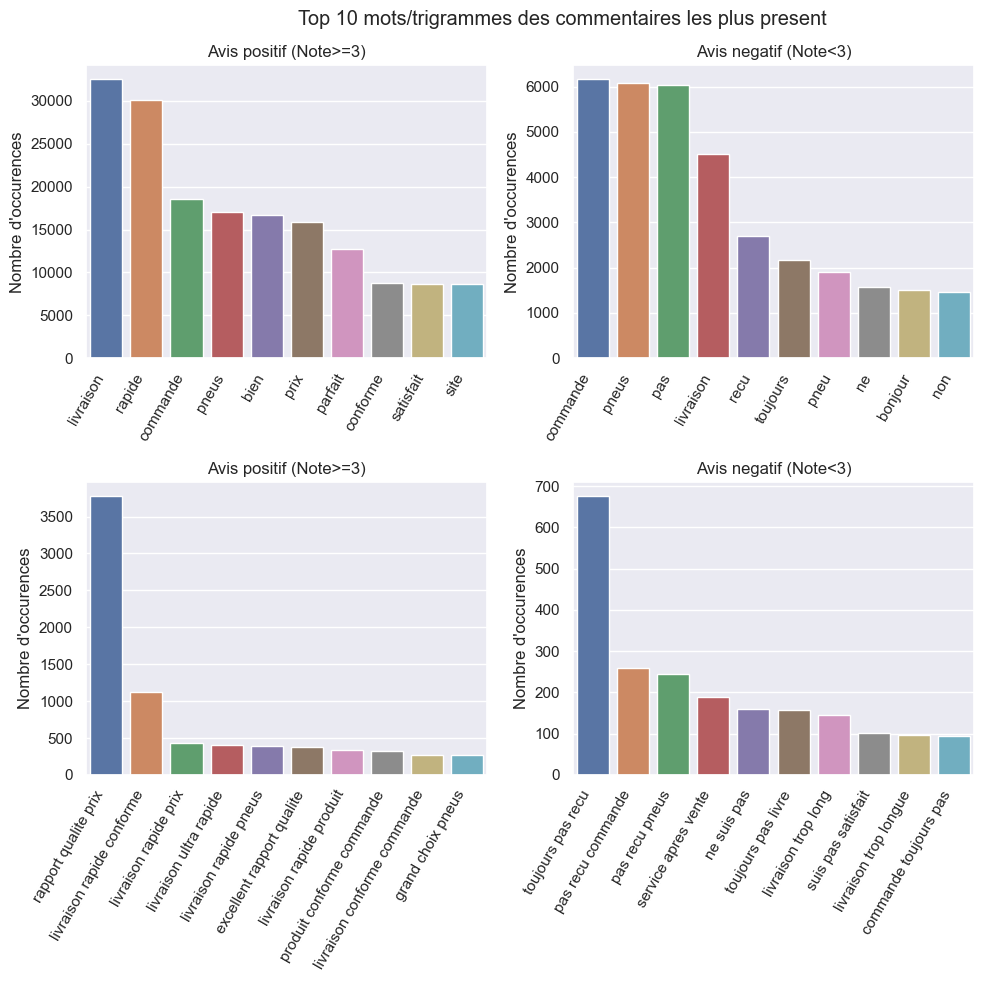

In [12]:
common_words = get_top_ngram(df.loc[df.Note<3]['Commentaire'].dropna().astype(str), n=5,ngrame=1,stopWord=True)
textCloud=''
for word, freq in common_words:
    textCloud += ' ' + word 
    print(word, freq)

print(textCloud)    
    
df_commonWord = pd.DataFrame(common_words,columns=['mots','count'])


ngrameNB=1
f, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,figsize=(10, 10))
f.suptitle('Top 10 mots/trigrammes des commentaires les plus present',x=0.57)
common_words1 = get_top_ngram(df.loc[df.Note>=3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord1 = pd.DataFrame(common_words1,columns=['mots','count'])
fig4=sns.barplot(data = df_commonWord1,x='mots',y='count',ax=ax1)
fig4.set_xticklabels(fig4.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig4.set(title='Avis positif (Note>=3)')
ax1.set_ylabel('Nombre d\'occurences')#.ylabel('Nombre d\'occurences')
ax1.set(xlabel=None)

common_words2 = get_top_ngram(df.loc[df.Note<3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord2 = pd.DataFrame(common_words2,columns=['mots','count'])
fig41=sns.barplot(data = df_commonWord2,x='mots',y='count',ax=ax2)
fig41.set_xticklabels(fig41.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig41.set(title='Avis negatif (Note<3)')
ax2.set_ylabel('Nombre d\'occurences')#plt.ylabel('Nombre d\'occurences')
ax2.set(xlabel=None)

ngrameNB=3
common_words3 = get_top_ngram(df.loc[df.Note>=3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord3 = pd.DataFrame(common_words3,columns=['mots','count'])
fig42=sns.barplot(data = df_commonWord3,x='mots',y='count',ax=ax3)
fig42.set_xticklabels(fig42.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig42.set(title='Avis positif (Note>=3)')
ax3.set_ylabel('Nombre d\'occurences')#.ylabel('Nombre d\'occurences')
ax3.set(xlabel=None)

common_words4 = get_top_ngram(df.loc[df.Note<3]['Titres'].dropna().astype(str), n=10,ngrame=ngrameNB,stopWord=True)
df_commonWord4 = pd.DataFrame(common_words4,columns=['mots','count'])
fig43=sns.barplot(data = df_commonWord4,x='mots',y='count',ax=ax4)
fig43.set_xticklabels(fig43.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig43.set(title='Avis negatif (Note<3)')
ax4.set_ylabel('Nombre d\'occurences')#plt.ylabel('Nombre d\'occurences')
ax4.set(xlabel=None)

# fig4=sns.barplot(data = df_commonWord,x='mots',y='count')
# fig4.set_xticklabels(fig4.get_xticklabels(),rotation=60,ha="right")
# plt.tight_layout()
# fig4.set(title='Top 5 mots des commentaires associes a une note positive')

# plt.ylabel('Nombre d\'occurences')
plt.show()

### Figure 5: Joint plot Note + Sentiment

PreProcessing:

In [7]:
# Code:

from textblob import Blobber
from textblob_fr import PatternTagger, PatternAnalyzer

#print(df.loc[df.Commentaire.apply(lambda x: not(isinstance(x, str)))].head())
df = df.drop(df.loc[df.Commentaire.apply(lambda x: not(isinstance(x, str)))].index)
df.reset_index()
#df.info()

# Definit objet blobber et configure les modeles francais
tb = Blobber(pos_tagger=PatternTagger(), analyzer=PatternAnalyzer())

# Fonction nettoyant le text
def preprocess(ReviewText):
    ReviewText = ReviewText.str.replace("(<br/>)", "")
    ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
    ReviewText = ReviewText.str.replace('(&amp)', '')
    ReviewText = ReviewText.str.replace('(&gt)', '')
    ReviewText = ReviewText.str.replace('(&lt)', '')
    ReviewText = ReviewText.str.replace('(\xa0)', ' ')
    return ReviewText

df['Commentaire'] = preprocess(df['Commentaire'])
df['polarity'] = df['Commentaire'].map(lambda text: tb(text).sentiment[0])


C:\Users\joan\AppData\Local\Temp\ipykernel_6064\1029177424.py:16: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace("(<br/>)", "")
C:\Users\joan\AppData\Local\Temp\ipykernel_6064\1029177424.py:17: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
C:\Users\joan\AppData\Local\Temp\ipykernel_6064\1029177424.py:18: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace('(&amp)', '')
C:\Users\joan\AppData\Local\Temp\ipykernel_6064\1029177424.py:19: FutureWarning: The default value of regex will change from True to False in a future version.
  ReviewText = ReviewText.str.replace('(&gt)', '')
C:\Users\joan\AppData\Local\Temp\ipykernel_6064\1029177424.py:20: FutureWarning: The default value of regex will change from True to False in

Plots:

In [10]:
trace1 = go.Scatter(
    x=df['polarity'], y=df['Note'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['polarity'], y=df['Note'], name='density', ncontours=20,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['polarity'], name='Sentiment polarity density',nbinsx=110,
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['Note'], name='Rating density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=1200,
    height=700,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
fig.update_layout(
    title={'text':"2D Density jointplot of Sentiment Polarity vs. Note",'xanchor':'center','yanchor':'top','x':0.5,'y':0.9},
    xaxis_title="Sentiment Polarity",
    yaxis_title="Note",
    margin=dict(t=100)
    )

fig.show()

### WORD CLOUD pour la Front page:

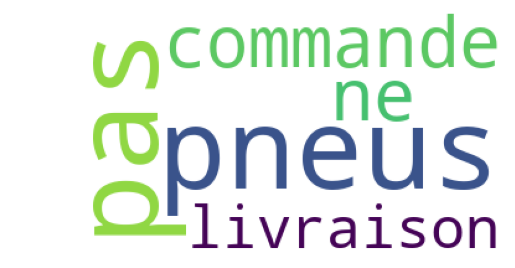

In [9]:
# import sys
# !{sys.executable} -m pip install wordcloud
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

wordcloud = WordCloud(background_color = 'white' , max_words = 40).generate(textCloud)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

### CORRELATION 